#**San Francisco Bay Area House Price Prediction**

**By: Melekot Ferrede**

Project Deliverables

1. Create and answer at least 5 unique questions using different types of plots to help you understand the data. You can create additional categorical columns or reshape your data to help you understand the data.

2. Create a test set and a training set using the original dataset. 

3. Use N-fold cross-validation to evaluate the performance of each model.

4. Use the appropriate performance metrics to evaluate the models. Select the best one for testing.

5. Test th best ML model using the test set. Include a confusion matrix to show the performance of the best class ML model.


how does the data visualization help you with choosing certain strategies in developing the ML training pipeline
what strategy is used to create test/train data
what ML models are chosen, and why are they suitable for this analysis
the performance of all trained models (including an image of the ROC curve)
how is the performance of the best ML model using the test set? 
To wrap up, discuss the challenges you have encountered and/or any other thoughts you have about this project. 


# #**SF Bay Area House Prices**

<img src="https://www.worldpropertyjournal.com/news-assets/San-Francisco-homes-california-keyimage.jpg" width=600>  
<font size=2 color=gray>Image Credit: World Property Journal</font>  


Bay Area real estate prices have been rapidly appreciating since 2012. Over the last decade, median property values have more than doubled, and some areas of the Bay Area have more than tripled!

The rapidly escalating prices are great for those that have already bought into the market. For potential homebuyers, these escalating prices result in getting less home for your dollar (and/or having to increase your budget), and gives pause as to not wanting to buy at the peak of the market.

Here is a data set of over 7,000 active listings from June 2019 containing factors influencing home prices across the region, including number of bedrooms and bathrooms, home size, lot size, school quality, and commute times. 

Here are the descriptions of the data:

- `Address` - the adddress of the house
- `City` - the city the house is at
- `State` - California, this data set is from the Bay Area
- `Zip` - postal zip code
- `Price` - listing price of the house
- `Beds` - number of bedrooms
- `Baths` - number of bathrooms
- `Home size` - the square footage of the house
- `Lot size` - the square footage of the lot 
- `Latitude` - latitude coordinate
- `Longitude` - longitude coodinate
- `SF time` - the commute time by car at 8 AM to San Francisco
- `PA time` - the commute time by car at 8 AM to commute to Palo Alto
- `School score` - the quality of the schools in the neighborhood
- `Commute time` - the commute time by car at 8 AM to the general Bay Area.

Data Source Credit: Michael Boles

###**Prediction**

You are tasked to build a ML model to predict the price of the homes in the SF Bay Area.

### importing the libraries 

In [ ]:
import pandas as pd
import folium
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
from scipy import stats
import matplotlib.image as mpimg
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer 
import seaborn as sns
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn import metrics
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor
from sklearn import metrics
from sklearn.svm import SVR
import xgboost
from sklearn.tree import DecisionTreeRegressor
import folium
import matplotlib.image as mpimg
import warnings; warnings.filterwarnings("ignore")
from plotly.offline import init_notebook_mode, iplot, plot
import plotly as py
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.express as px

In [ ]:
data='https://raw.githubusercontent.com/csbfx/cs133/main/sf_bayarea_house_prices.csv'
df = pd.read_csv(data)
df

,Address,City,State,Zip,Price,Beds,Baths,Home size,Lot size,Latitude,Longitude,SF time,PA time,School score,Commute time
0,2412 Palmer Ave,Belmont,CA,94002,1459000,3,2.0,1360.0,5001.0,37.516781,-122.304623,63,33,77.9,33
1,1909 Hillman Ave,Belmont,CA,94002,1595000,4,2.0,2220.0,3999.0,37.521972,-122.294079,63,33,77.9,33
2,641 Waltermire St,Belmont,CA,94002,899999,2,1.0,840.0,4234.0,37.520233,-122.273144,63,33,77.9,33
3,2706 Sequoia Way,Belmont,CA,94002,1588000,3,2.0,1860.0,5210.0,37.520192,-122.309437,63,33,77.9,33
4,1568 Winding Way,Belmont,CA,94002,1999000,4,3.5,2900.0,16117.2,37.524280,-122.291241,63,33,77.9,33
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7140,The Davis,Mountain House,CA,95391,603990,5,3.0,2327.0,NaN,37.756444,-121.547719,120,125,65.3,120
7141,The Berkeley,Mountain House,CA,95391,619990,5,4.0,2410.0,NaN,37.756444,-121.547719,120,125,65.3,120
7142,Geranium,Mountain House,CA,95391,666340,5,4.0,2486.0,NaN,37.764721,-121.537761,120,125,65.3,120
7143,The Pepperdine,Mountain House,CA,95391,659990,5,4.0,2856.0,NaN,37.756444,-121.547719,120,125,65.3,120


## save `dfraw` as the data from the csv file

In [ ]:
#make a copy version of raw data
dfraw = df

#Part 1: perform the data analysis and visualization

In [ ]:
#checking the datatype
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7145 entries, 0 to 7144
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Address       7137 non-null   object 
 1   City          7145 non-null   object 
 2   State         7145 non-null   object 
 3   Zip           7145 non-null   int64  
 4   Price         7145 non-null   int64  
 5   Beds          7145 non-null   int64  
 6   Baths         7145 non-null   float64
 7   Home size     7063 non-null   float64
 8   Lot size      6880 non-null   float64
 9   Latitude      7145 non-null   float64
 10  Longitude     7145 non-null   float64
 11  SF time       7145 non-null   int64  
 12  PA time       7145 non-null   int64  
 13  School score  7085 non-null   float64
 14  Commute time  7145 non-null   int64  
dtypes: float64(6), int64(6), object(3)
memory usage: 837.4+ KB


In [ ]:
df.describe()

,Zip,Price,Beds,Baths,Home size,Lot size,Latitude,Longitude,SF time,PA time,School score,Commute time
count,7145.000000,7.145000e+03,7145.000000,7145.000000,7063.000000,6.880000e+03,7145.000000,7145.000000,7145.000000,7145.000000,7085.000000,7145.000000
mean,94610.732120,1.676225e+06,3.594822,2.572498,2244.186040,2.807283e+04,37.692989,-122.124319,83.335899,83.850385,52.669273,67.370749
std,343.763512,2.407593e+06,1.030743,1.127692,1369.340525,3.215086e+05,0.262637,0.238086,27.048451,34.195327,20.007771,29.160700
min,94002.000000,1.290000e+05,1.000000,1.000000,107.000000,4.360000e+02,37.150065,-122.698597,8.000000,5.000000,17.100000,5.000000
25%,94509.000000,7.299500e+05,3.000000,2.000000,1408.000000,4.850750e+03,37.450607,-122.281695,65.000000,60.000000,33.800000,47.000000
50%,94572.000000,1.099988e+06,4.000000,2.500000,1904.000000,6.477000e+03,37.741127,-122.117378,90.000000,85.000000,50.900000,63.000000
75%,94920.000000,1.699000e+06,4.000000,3.000000,2646.500000,1.001880e+04,37.915970,-121.951238,100.000000,110.000000,71.000000,90.000000
max,95391.000000,4.999000e+07,13.000000,11.000000,20982.000000,1.364561e+07,38.149218,-121.503746,170.000000,150.000000,89.800000,135.000000


In [ ]:
df_drop = df.dropna(subset=['Address'])
df_drop.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7137 entries, 0 to 7144
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Address       7137 non-null   object 
 1   City          7137 non-null   object 
 2   State         7137 non-null   object 
 3   Zip           7137 non-null   int64  
 4   Price         7137 non-null   int64  
 5   Beds          7137 non-null   int64  
 6   Baths         7137 non-null   float64
 7   Home size     7055 non-null   float64
 8   Lot size      6872 non-null   float64
 9   Latitude      7137 non-null   float64
 10  Longitude     7137 non-null   float64
 11  SF time       7137 non-null   int64  
 12  PA time       7137 non-null   int64  
 13  School score  7077 non-null   float64
 14  Commute time  7137 non-null   int64  
dtypes: float64(6), int64(6), object(3)
memory usage: 892.1+ KB


In [ ]:
df_drop_raw = df_drop
# must run this line

In [ ]:
!pip install usaddress
import usaddress

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
street_dict = []
street_numbers = []
street_address = []
temp = ""
count = 0

df = df.dropna(subset=['Address'])

for i in df.Address:
  if i != 'nan':
    street_dict.append(usaddress.parse(i))
    if len(street_dict[count]) == 1:
      street_address.append(street_dict[count][0][0])
    else:
      street_numbers.append(street_dict[count][0][0])
      for i in range(1, len(street_dict[count])):
        temp = temp + " " + street_dict[count][i][0]
      street_address.append(temp)
      temp = ""
    count = count + 1

In [ ]:
len(street_address)

7137

In [ ]:
df['Address'] = street_address

In [ ]:
df['Address'].nunique()

4654

###checking the null values

In [ ]:
#checking the null values
df.isna().sum()

Address           0
City              0
State             0
Zip               0
Price             0
Beds              0
Baths             0
Home size        82
Lot size        265
Latitude          0
Longitude         0
SF time           0
PA time           0
School score     60
Commute time      0
dtype: int64

###Plotting the target variable

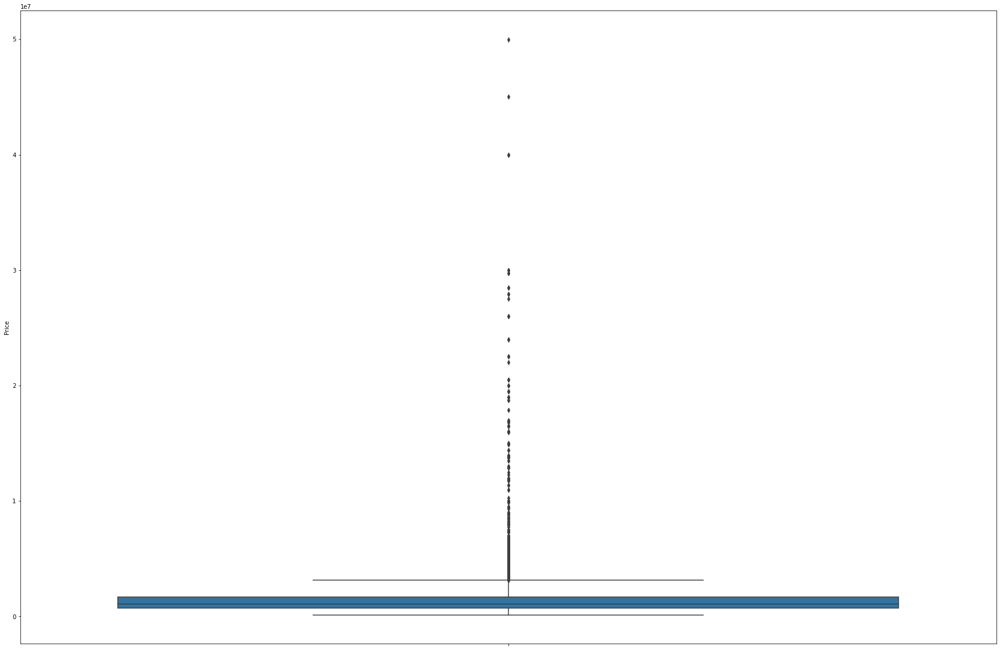

In [ ]:
fig, ax = plt.subplots(figsize=(30, 20))
sns.boxplot(y='Price', data=df)

### Using interquantile range getting the value of outliers and removing them from the dataset

In [ ]:
q1,q3 = df['Price'].quantile([.25,.75])

In [ ]:
IQR = q3 - q1

lower_limit = q1 - IQR*1.5
upper_limit = q3 + IQR*1.5

print(lower_limit )
print(upper_limit)

-723500.0
3152500.0


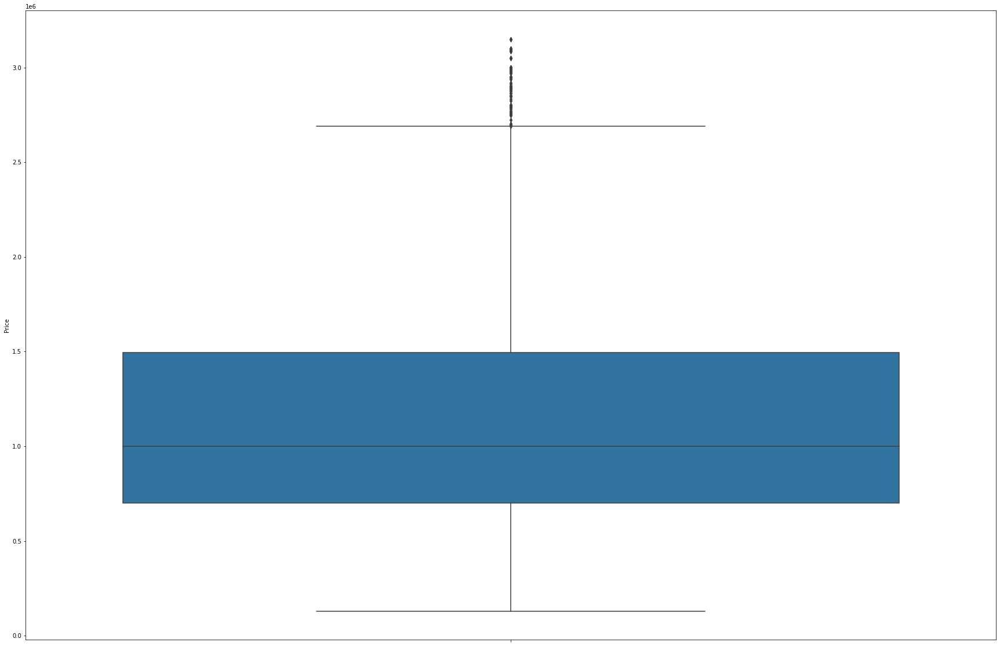

In [ ]:
df = df[(df['Price']<= 3152575) & (df['Price']>-723625)]
data = df.drop(['Price'],axis = 1)
fig, ax = plt.subplots(figsize=(30, 20))
sns.boxplot(y='Price', data=df)

In [ ]:
# ## checking for the lot size
# fig, ax = plt.subplots(figsize=(10, 10))
# sns.boxplot(y='Lot size', data=df)

In [ ]:
# q1,q3 = df['Lot size'].quantile([.25,.75])

##**Question 1:** Which attribute of the initial data had the most significant effect on the price of a home? And following that, were there any attributes that had minimal impact on the predicted price of a home?

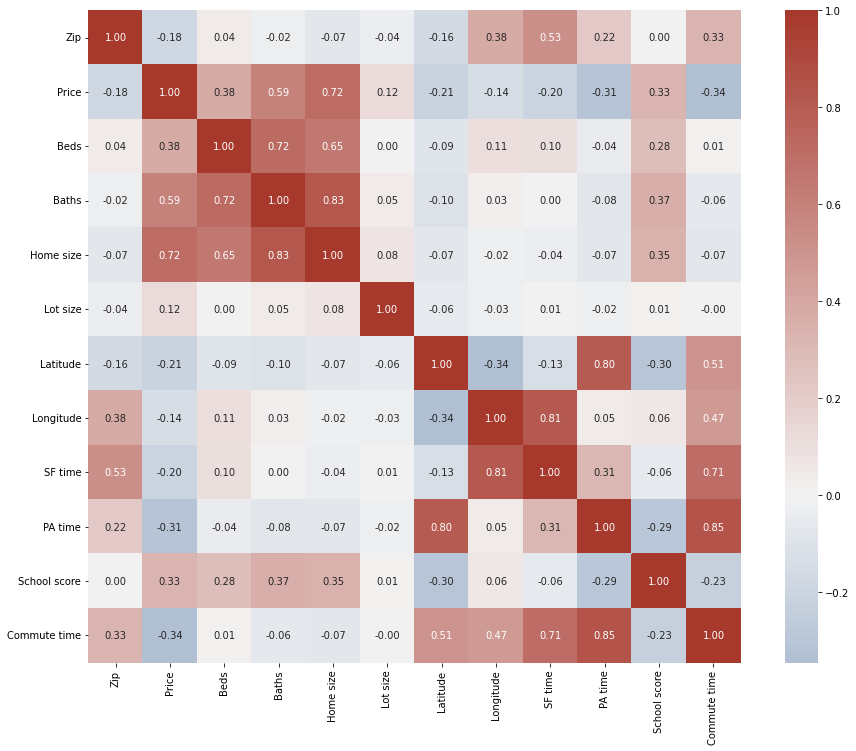

In [ ]:
base_df = pd.read_csv('https://raw.githubusercontent.com/csbfx/cs133/main/sf_bayarea_house_prices.csv')
corr_matrix = base_df.corr()

plt.figure(figsize=(16,12))

cmap = sns.diverging_palette(250, 15, s=75, l=40,
                             n=9, center="light", as_cmap=True)

_ = sns.heatmap(corr_matrix, center=0, annot=True, 
                fmt='.2f', square=True, cmap=cmap)

### From here though we see that Beds/Baths/Home Size/School score have the highest correlation with price. Now let's merge some features and see if we can find some strongely correlated features. Lets try and combine beds and baths.

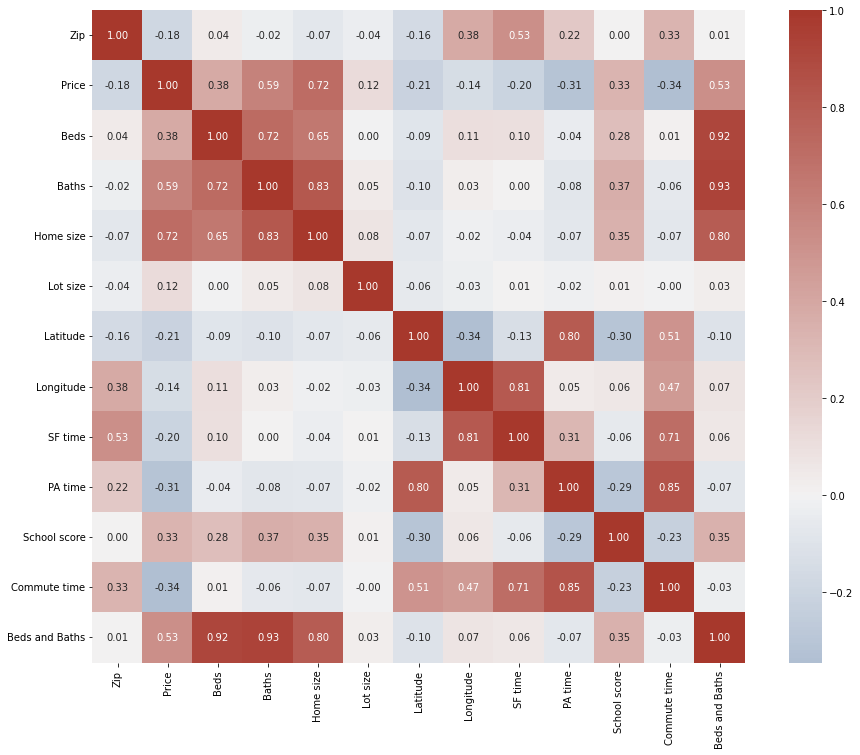

In [ ]:
base_df['Beds and Baths'] = base_df.Beds + base_df.Baths
aug_corr_matrix = base_df.corr()

plt.figure(figsize=(16,12))

cmap = sns.diverging_palette(250, 15, s=75, l=40,
                             n=9, center="light", as_cmap=True)

_ = sns.heatmap(aug_corr_matrix, center=0, annot=True, 
                fmt='.2f', square=True, cmap=cmap)

**Answer:**

Seeing this, we can tell that Beds, Baths, and Home Size correlate the strongest with the price of a home, and combining beds and baths did not the overall correlation betweent the two values. We can compare these values to which features the model found most important after training.

##**Question 2**:Which area of the Bay Area commanded the largest price disparities in terms of housing price? Which were areas most and least valuable?

### We can start by finding the median Price of homes by city, and finding the direct value, to find which homes were most and least valuable.

In [ ]:
city_df = df.groupby(by=["City"], dropna=False).Price.median().sort_values()
city_df

City
Spbl             370000.0
Vallejo          450000.0
Pittsburg        485000.0
San Pablo        499000.0
Antioch          499900.0
                  ...    
Los Altos       2728000.0
Ross            2747000.0
Hillsborough    2795000.0
Monte Sereno    2898000.0
Belvedere       3000000.0
Name: Price, Length: 115, dtype: float64

### This doesn't tell us about distribution of price within the cities itself, are there cities with expensive outliers, or a large disparity within the 25th and 75th percentiles.

In [ ]:
fig = px.box(df, x="City", y="Price")
fig.show(renderer="colab")

### This actually answers our question, we can see belvedere has the highest disparity between it's 25th and 75th percentile home values, although Atherton isn't so far behind. These two cities are also the most expensive places in the Bay Area.

### But we also want to know how the most populous cities distributions are, certain cities like Los Altos Hills have very few homes as part of the dataset. Lets filter the cities by occurance within the dataset, and see distributions of those cities.


In [ ]:
df.City.value_counts().mean()

56.530434782608694

In [ ]:
vc = df.City.value_counts()

relevant_cities = df[df.City.isin(vc.index[vc.values > 61])]

relevant_cities.City.value_counts()

San Jose          807
Oakland           504
San Francisco     391
Vallejo           219
Hayward           204
Concord           174
Fremont           171
Richmond          153
Walnut Creek      146
Martinez          127
Novato            123
San Ramon         118
Berkeley          110
Santa Clara       108
Pittsburg         104
San Mateo          96
Sunnyvale          89
Milpitas           88
Livermore          87
Antioch            87
San Leandro        86
Pleasanton         85
Danville           84
Redwood City       83
San Rafael         82
Discovery Bay      82
Los Gatos          81
Orinda             80
Oakley             80
Mountain House     78
Castro Valley      73
Alameda            62
Name: City, dtype: int64

In [ ]:
from matplotlib.pyplot import figure

fig = px.box(relevant_cities, x="Price", y="City")

fig.update_layout(
    autosize=False,
    width=2500,
    height=1000,
    margin=dict(
        l=50,
        r=50,
        b=100,
        t=100,
        pad=4
    ),
    paper_bgcolor="LightSteelBlue",
)

fig.show(renderer="colab")

This shows us of the most populous cities, Palo Alto has by far the wides disparity, although San Francisco has a very large amount of outliers that are pretty notable as well.

We can try now to make a violin plot and see a continuous distribution, although the amount of cities means the visualization would be too cluttered if we attempted to make a violin plot for each city, so we'll make one for the general price distribution.

In [ ]:
fig = px.violin(relevant_cities, y="Price", box=True, # draw box plot inside the violin
                points='all', # can be 'outliers', or False
               )

fig.update_layout(
    autosize=False,
    width=2500,
    height=1000,
    margin=dict(
        l=50,
        r=50,
        b=100,
        t=100,
        pad=4
    ),
    paper_bgcolor="LightSteelBlue",
)
fig.show(renderer="colab")

**Answer:**

We've already seen it but Atherton and Palo Alto have the widest disparities, depending on whether or not you filter by amount of homes within the dataset.

##**Question 3**: How does SF and PA commute time affect the housing prices?

##We want to know how the two important development cores San Francisco (SF) and Palo Alto (PA) affect the price. We make scatter plot with x axis = `SF time` and y axis = `PA time`. The dots near oringin point have the shortest total commute time.

##Then we added a red line of "y=x" so dots on the red line have the equal time commute to SF and to PA. And if the distribution of some dots forms a line that is vertical to the red line, they have the same total commute time.


##So we can compare the dots near the origin point with the dots far away from the zero point. And we can compare the dots that have the same total commute time.

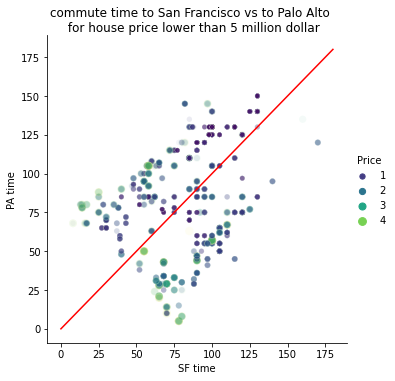

<Figure size 720x720 with 0 Axes>

In [ ]:
import numpy as np
g = sns.relplot(data=df_drop[df_drop['Price']<5000000], x='SF time', y='PA time', hue='Price',size='Price', palette = "viridis", alpha=0.05, legend='auto');
X_plot = np.linspace(0, 180)
Y_plot = X_plot
plt.plot(X_plot, Y_plot, color='r');
plt.figure(figsize=(10,10))
g.fig.suptitle('commute time to San Francisco vs to Palo Alto \n for house price lower than 5 million dollar', y= 1.05);

**Answer:**

(1)The price increase with total commute time (SF time + PA time). 

(2)For the houses with the shortest total commute time, the ones near Palo Alto have higher prices (the dots at the very bottom)

##**Question 4**: How do house prices of records distribute, with a representation of school scores?

### We want to make a scatter plot on a fixed base map. So we first find the range of Longitude and Latitude, and then make a base map based on the range, using ArcGIS. 

In [ ]:
#check the range of the records
print(dfraw['Longitude'].max())
print(dfraw['Longitude'].min())
print(dfraw['Latitude'].max())
print(dfraw['Latitude'].min())

-121.503746
-122.698597
38.149218
37.150065


In [ ]:
print(dfraw['Longitude'].mean())
print(dfraw['Latitude'].mean())

-122.12431873296012
37.692988783065076


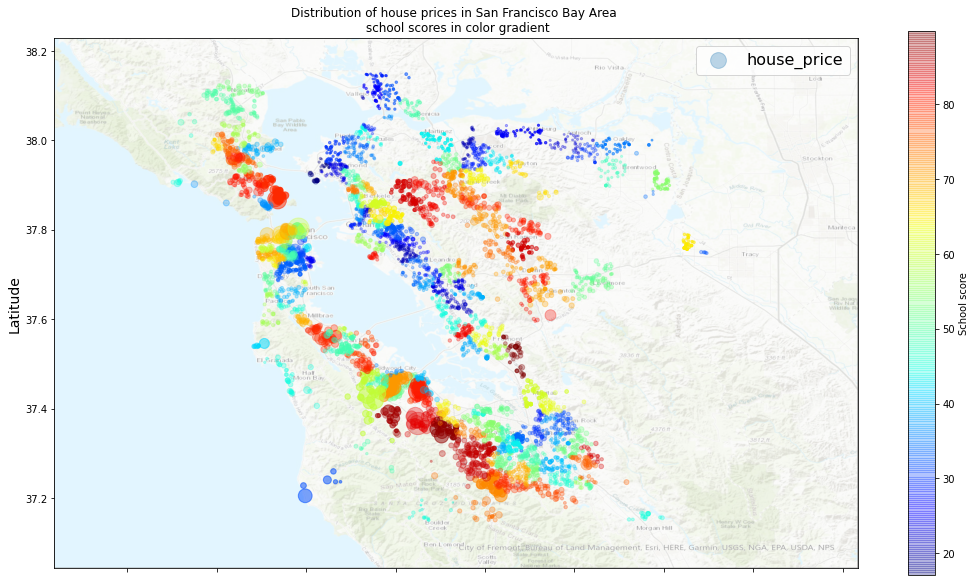

In [ ]:
SFBA=mpimg.imread('https://github.com/Xiangyusherry/CA_SF_housing_price/blob/main/SFBA.png?raw=true')

ax = df_drop_raw.plot(kind="scatter", 
                  x="Longitude", y="Latitude", figsize=(18,10),
                  s=df_drop_raw['Price']/100000, label="house_price", c="School score", cmap=plt.get_cmap("jet"),alpha=0.3)
plt.imshow(SFBA, extent=[-122.9631436, -121.1653953, 37.0420726, 38.2300720], alpha=0.5, cmap=plt.get_cmap("jet"))
plt.ylabel("Latitude", fontsize=14)
plt.xlabel("Longitude", fontsize=14)
plt.legend(fontsize=16)

plt.title('Distribution of house prices in San Francisco Bay Area \n school scores in color gradient');
plt.show()

**Answer:**

(1) Good schools cluster at the southwest and northeast of Bay Area.

(2) House price usually increase with the school score, except the ones in the East Bay Area.

##**Question 5**: How does the price per square footage of the house distribute in SF Bay Area?

In [ ]:
!pip install plotly==5.10.0 
!pip install plotly.express --quiet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


###Because there are many expensive mansions in the bay area. We want to normalize the price by the house size. And we want to know the distribution

In [ ]:
# Create a Choropleth map to show the average house price per  by county in California
#create a column of "price per square footage of the house"
df_drop_raw['price_per_ft_House'] = round((df_drop_raw['Price']/df_drop_raw['Home size']), 2)
df_drop_raw['price_per_ft_Lot'] = round((df_drop_raw['Price']/df_drop_raw['Lot size']), 2)
df_drop_pph = pd.DataFrame(df_drop_raw.groupby('City')['price_per_ft_House'].mean())
df_drop_pph = df_drop_pph.reset_index()
df_drop_pph

,City,price_per_ft_House
0,Alameda,615.191452
1,Alamo,559.814773
2,Albany,726.447917
3,Antioch,257.114253
4,Atherton,1966.775500
...,...,...
112,Union City,549.119318
113,Vallejo,296.464018
114,Walnut Creek,540.531233
115,Woodacre,470.021667


###Load in our geojson file of city boudary in CA.
The link to website where anyone can download the file is https://data.cnra.ca.gov/dataset/city-boundaries/resource/ffb029a2-bc7d-4f64-bb6b-6a1c88978489 

In [ ]:
cacity_shape = 'City_Boundaries.geojson'

In [ ]:
#make a choropleth map
bins = list(df_drop_pph['price_per_ft_House'].quantile([0, 0.25, 0.50, 0.75, 1]))
pricemap = folium.Map(location=[37.692988783065076, -122.12431873296012], zoom_start=9)

choropleth = folium.Choropleth(
    geo_data = cacity_shape,
    data = df_drop_pph,
    name='choropleth',
    columns=['City', 'price_per_ft_House'],
    fill_color= 'BuPu',
    key_on='properties.CITY',
    fill_opacity=0.7,
    line_opacity=0.6,
    legend_name='Average Price per Footage of House',
    bins = bins,
).add_to(pricemap)

style_function = "font-size: 15px; font-weight: bold"
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['CITY'],style=style_function, labels=False)
)

pricemap

**Answer :**

The price per square footage of the house show in the Folium map with the color scale. The high price per square footage of house locate along the shore all the way from Santa Clara to Millbrae.

##**Question 6**: For Price<= 5 million, how does the ratio of house to lot affect housing price in the top 4 cities with the largest number of records?

In [ ]:
df_drop_raw['City'].value_counts()[0:4]

San Jose         821
Oakland          504
San Francisco    470
Vallejo          219
Name: City, dtype: int64

In [ ]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

### Add a column of house price type. So we can choose to plot house over or under 5 millioni dollars.

In [ ]:
def div(x):
  if x.Price <= 5000000:
    return '<=5million'
  else:
    return '>5million'

df_drop_raw['price_div'] = df_drop_raw.apply(div, axis='columns')
df_drop_raw.value_counts('price_div')

price_div
<=5million    6853
>5million      284
dtype: int64

###We built the column of the ratio of house size to lot size, it shows the density of construction. It also indicates the type of home, apartment, townhouse, single-family house, etc.

In [ ]:
df_drop_raw['house_in_lot'] = round((df_drop_raw['Home size']/df_drop_raw['Lot size']), 2)

In [ ]:
#make dataframe for the 4 cities
dfSJ = df_drop_raw[df_drop_raw['price_div']=='<=5million'].loc[df_drop_raw['City'] == 'San Jose']
dfOK = df_drop_raw[df_drop_raw['price_div']=='<=5million'].loc[df_drop_raw['City'] == 'Oakland']
dfSF = df_drop_raw[df_drop_raw['price_div']=='<=5million'].loc[df_drop_raw['City'] == 'San Francisco']
dfVL = df_drop_raw[df_drop_raw['price_div']=='<=5million'].loc[df_drop_raw['City'] == 'Vallejo']

In [ ]:
import plotly.express as px
configure_plotly_browser_state()

trace1 =go.Scatter(
                    x = dfSJ.house_in_lot,
                    y = dfSJ.Price,
                    mode = "markers",
                    name = "San Jose",
                    marker = dict(color = 'rgba(252, 111, 144, 0.8)'),
                    text= dfSJ.City)
trace2 =go.Scatter(
                    x = dfOK.house_in_lot,
                    y = dfOK.Price,
                    mode = "markers",
                    name = "Oakland",
                    marker = dict(color = 'rgba(132, 213, 240, 0.8)'),
                    text= dfOK.City)
trace3 =go.Scatter(
                    x = dfSF.house_in_lot,
                    y = dfSF.Price,
                    mode = "markers",
                    name = "San Francisco",
                    marker = dict(color = 'rgba(88, 245, 117, 0.8)'),
                    text= dfSF.City)
trace4 =go.Scatter(
                    x = dfVL.house_in_lot,
                    y = dfVL.Price,
                    mode = "markers",
                    name = "Vallejo",
                    marker = dict(color = 'rgba(160, 137, 245, 0.8)'),
                    text= dfVL.City)



data = [trace1, trace2, trace3, trace4]
layout = dict(title = 'The ratio of house to lot affect housing price in the top 4 cities with the largest number of records(For Price<= 5 million)',
              xaxis= dict(title= 'The ratio of home size to lot size',ticklen=10,zeroline= False),
              yaxis= dict(title= 'Price',ticklen= 5,zeroline= False)
             )
fig = dict(data = data, layout = layout)
iplot(fig)

**Answer:**

For houses in San Francisco, the ones with high "house in lot" rate tend to have higher prices. Many high value houses have a "house in lot" rate larger than 1.

For houses in San Jose, the ones with high prices tend to have low "house in lot". Many high value houses have a "house in lot" rate smaller than 0.6, meaning that they are more likely to be flat single family house.

In Oakland, the homes with higher "house in lot" does not show a high price.

For houses in Vallejo, homes are almost all flat single family house with lower prices than the other three cities.

##**Question 7**: for the homes with extremely high value, in which cities do they locate?

###First, set a dataframe that contains the name of city and the number of house with higher value than 5 million dollars.

In [ ]:
df_e = df_drop_raw[df_drop_raw['price_div']=='>5million'].groupby('City').Price.count()
df8 = pd.DataFrame(df_e).sort_values('Price', ascending= [False]).reset_index()
df8.columns = ['City','Number']
df8

,City,Number
0,Atherton,52
1,Palo Alto,38
2,San Francisco,32
3,Los Altos Hills,20
4,Woodside,18
5,Los Gatos,17
6,Tiburon,15
7,Hillsborough,13
8,Belvedere,12
9,Los Altos,11


### And within all the 27 cities, we choose the top 10 cities have the largest number of expensive mansions. Then a interactive plot was made to show the city name and number of expensive house.

In [ ]:
import plotly.express as px
configure_plotly_browser_state()

pie1 = df8.iloc[0:10].Number
labels = df8.iloc[0:10].City

fig = {
  "data": [
    {
      "values": pie1,
      "labels": labels,
      "domain": {"x": [0, .5]},
      "name": " ",
      "text": pie1,
      "hovertemplate":"%{label}:  # of records: %{text}",
      "hole": .3,
      "type": "pie"
    },],
  "layout": {
        "title":"Top 10 cities that have the largest number of expensive homes from the SFBA",
        "annotations": [
            { "font": { "size": 12},
              "showarrow": False,
              "text": " ",
                "x": 0.5,
                "y": 0.8
            },
        ]
    }
}
iplot(fig)

### And we want to know where are those cities with expensive home.

In [ ]:
!pip install geopy 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


### we use `geopy` to find the latitude and longitude of the 10 cites.

In [ ]:
from geopy.exc import GeocoderTimedOut
from geopy.geocoders import Nominatim

longitude = []
latitude = []

# function to find the coordinate of a given city 
def findGeocode(city):
    try:
        geolocator = Nominatim(user_agent="CS133")
        return geolocator.geocode(city)
    except GeocoderTimedOut:
        return None

for i in (df8['City']):
    if findGeocode(i) != None:
        loc = findGeocode(i)
        latitude.append(loc.latitude)
        longitude.append(loc.longitude)
    else:
        latitude.append(np.nan)
        longitude.append(np.nan)

df8["Longitude"] = longitude
df8["Latitude"] = latitude
df8

,City,Number,Longitude,Latitude
0,Atherton,52,-122.205827,37.453773
1,Palo Alto,38,-122.159847,37.444329
2,San Francisco,32,-122.419906,37.779026
3,Los Altos Hills,20,-122.137463,37.379663
4,Woodside,18,-122.253855,37.429939
5,Los Gatos,17,-121.974680,37.226611
6,Tiburon,15,-74.395922,18.326730
7,Hillsborough,13,-82.348806,27.918454
8,Belvedere,12,16.380402,48.193917
9,Los Altos,11,-3.620210,42.781157


###Then we made Folium map. The size of bubble indicate the number of the expensive house. The city name popup to help reading the map.

In [ ]:
mansionmap = folium.Map(location=[37.692988783065076, -122.12431873296012], zoom_start=9)

for i in range(0,len(df8)):
   number = float(df8.iloc[i]['Number'])  #json cannot serialize int64
   lat = float(df8.iloc[i]['Latitude'])
   long_ = float(df8.iloc[i]['Longitude'])
   folium.Circle(
      location=[lat, long_],
      popup=df8.iloc[i]['City']+', '+str(df8.iloc[i]['Number']), 
      radius=number*200,
      color='purple',
      fill=True,
      fill_color='purple'
   ).add_to(mansionmap)

# Show the map
mansionmap

###**Answer**: The cities have expensive mansions cluster near Atherton and Palo Alto area, and SF. The locations can be seen on the interactive map with city names popup when the bubble is clicked.

# Splitting the data into train and test dataset , and using stratify to bin the target variable


In [ ]:
# removing the columns from the data
df = df.drop(['Address', 'State','Latitude','Longitude'],axis =1)

In [ ]:
# changing the zip code dtype
df['Zip'] = df['Zip'].astype('object')

In [ ]:
### Splitting train test
## creating bins for my numerical target column
labels = df['Price'].to_numpy()

bin_count = 5
bin_numbers = pd.qcut(
    x=labels, q=bin_count, labels=False, duplicates='drop') #here we converted the data to the bins

In [ ]:
df1= df.drop('Price' , axis = 1)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(df1, df['Price'], test_size=0.20, stratify=bin_numbers , random_state=42)

Visualization of the distribution of the train set and the test set

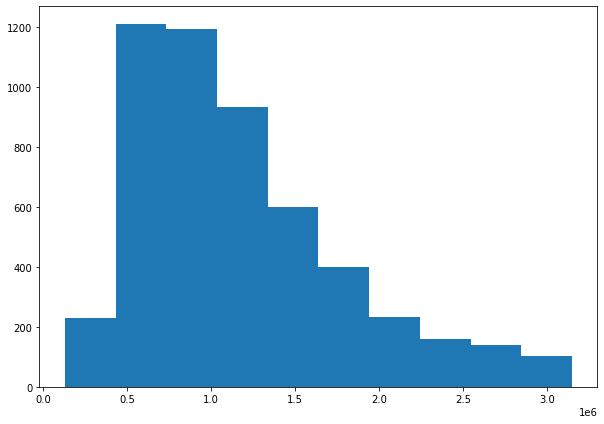

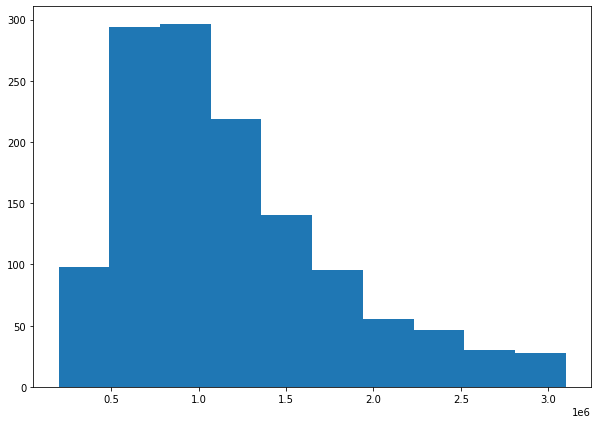

In [ ]:
# checking the distribution of the test price and train price
# Creating histogram
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(y_train)
plt.show()
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(y_test)
plt.show()

In [ ]:
## checking the null values and checking the dtype of the columns
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5200 entries, 4946 to 566
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   City          5200 non-null   object 
 1   Zip           5200 non-null   object 
 2   Beds          5200 non-null   int64  
 3   Baths         5200 non-null   float64
 4   Home size     5161 non-null   float64
 5   Lot size      4987 non-null   float64
 6   SF time       5200 non-null   int64  
 7   PA time       5200 non-null   int64  
 8   School score  5166 non-null   float64
 9   Commute time  5200 non-null   int64  
dtypes: float64(4), int64(4), object(2)
memory usage: 446.9+ KB


In [ ]:
## Selecting the numerical data

In [ ]:
df_num = X_train.select_dtypes(include=['int64','float64'])
print(df_num.head())

      Beds  Baths  Home size  Lot size  SF time  PA time  School score  \
4946     3    2.0     1345.0    7405.0       67       97          69.4   
6136     4    4.0     3234.0   11761.2       90       36          54.8   
2099     3    2.5     1607.0    4815.0      110      130          42.8   
7109     4    3.0     2304.0    3633.0      120      125          65.3   
2126     4    3.0     2000.0    6600.0       90      115          52.2   

      Commute time  
4946            67  
6136            36  
2099           110  
7109           120  
2126            90  


In [ ]:
## Visualization of the numerical data , to see the outliers using the box plot

Beds


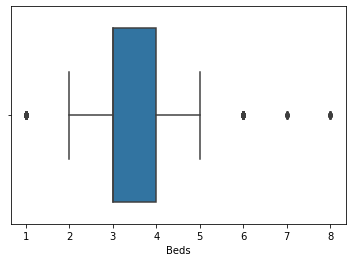

Baths


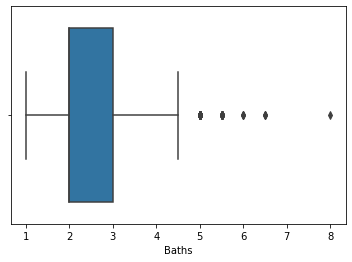

Home size


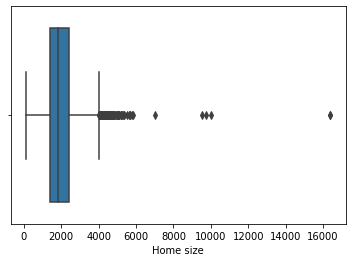

Lot size


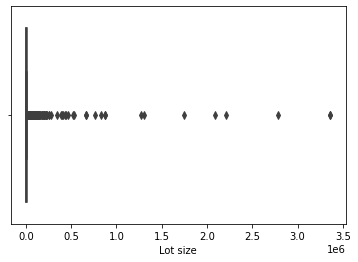

SF time


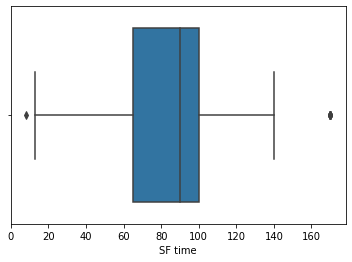

PA time


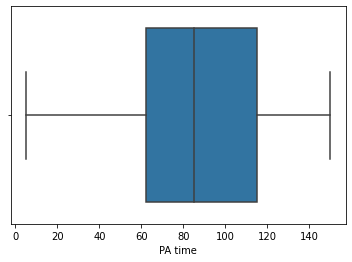

School score


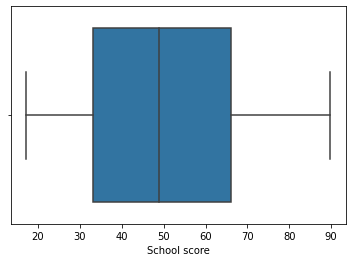

Commute time


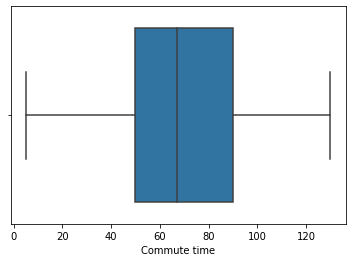

In [ ]:
for i in list(df_num.columns):
  print(i)
  sns.boxplot(x=df_num[i])
  plt.show()

Visualization of the categorical values

City


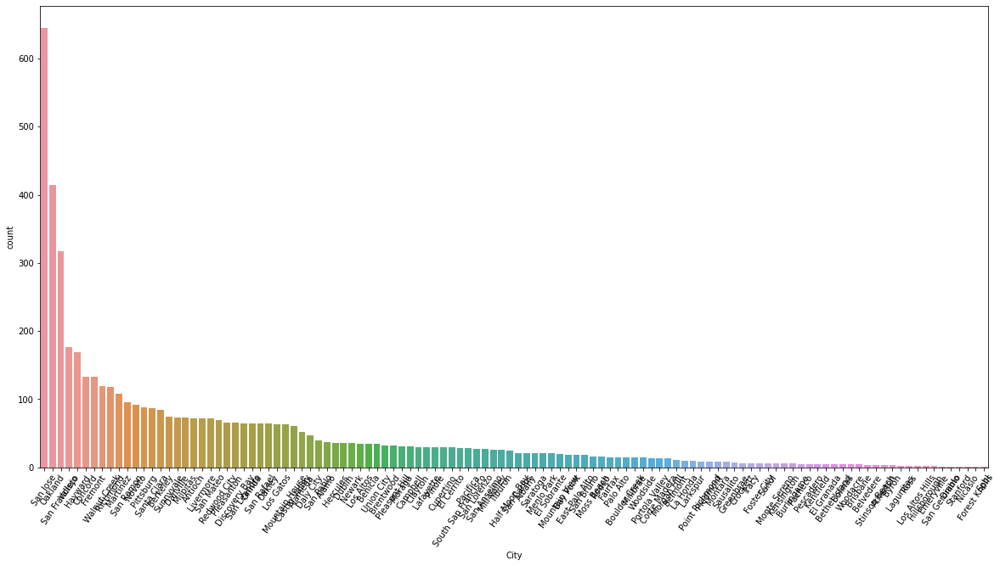

Zip


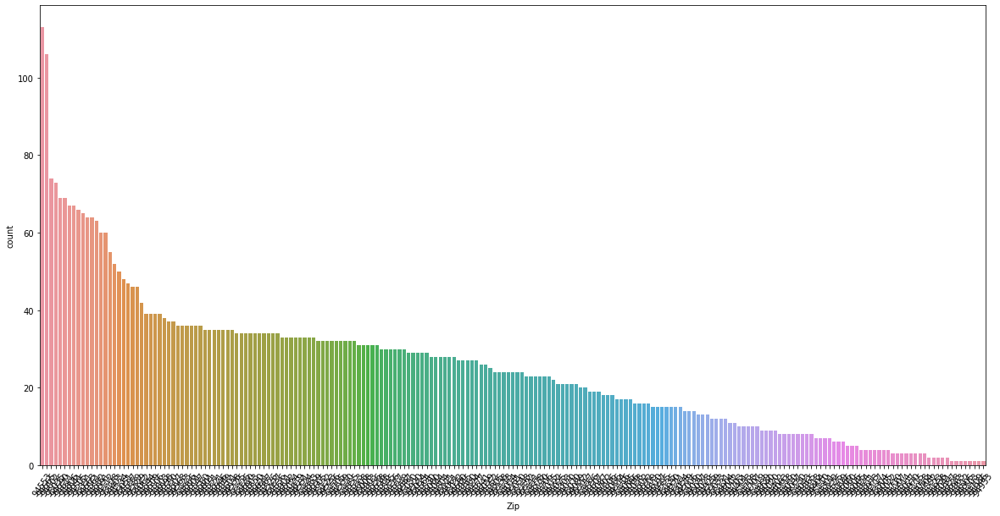

In [ ]:
catcols = X_train.select_dtypes(include=['object'])
catcols.head()
for col in catcols.columns:
    print(col)
    plt.figure(figsize= (20,10))
    sns.countplot(catcols[col] ,order = catcols[col].value_counts().index);
    plt.xticks(rotation=55)
    plt.show();

In [ ]:
# creating list containing numerical attributes and categorical variable
num_attribs = ['Beds', 'Baths', 'Home size', 'Lot size', 'SF time', 'PA time',
       'School score', 'Commute time']
cat_attribs =['City', 'Zip']

Creating Data pipeline for preprocessing of the training
data

In [ ]:
catcols.columns

Index(['City', 'Zip'], dtype='object')

In [ ]:
catdata = X_train[['City', 'Zip']]

In [ ]:
# this will be used to retriev the categorical columns that will used to allot after one hot encoding using datapipeling
cat_encoder = OneHotEncoder()
housing_cat_1hot = cat_encoder.fit_transform(catdata)

In [ ]:
num_pipeline = Pipeline([
        ('imputer', SimpleImputer(strategy="median")), # fill in missing values with median values
        ('std_scaler', StandardScaler()),              # feature scaling
    ])

cat_pipeline = Pipeline([
        ('imputer', SimpleImputer(strategy="most_frequent")), # fill in missing values with most frequent values
        ('onehotencoding', OneHotEncoder()),        
    ])

full_pipeline = ColumnTransformer([
        ("num", num_pipeline, num_attribs),
        ("cat" ,cat_pipeline, cat_attribs)

    ])

Transforming the training dataset using pipeline

In [ ]:
train_data = full_pipeline.fit_transform(X_train)

In [ ]:
## concatinating the numerical attributes names and categorical names
catcols1 = []
for i in range(len(cat_encoder.categories_)):
  catcols1 = catcols1 + cat_encoder.categories_[i].tolist()

cols = num_attribs + catcols1


In [ ]:
data = train_data.toarray()

In [ ]:
#converting the data into dataframe
train_x = pd.DataFrame(data,columns = cols , index = X_train.index)

In [ ]:
train_x.head()

,Beds,Baths,Home size,Lot size,SF time,PA time,School score,Commute time,Alameda,Alamo,...,95131,95132,95133,95135,95136,95138,95139,95148,95304,95391
4946,-0.522382,-0.448980,-0.727211,-0.073380,-0.671564,0.314029,0.953991,-0.116369,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6136,0.535813,1.830442,1.362230,-0.029924,0.181451,-1.549475,0.205258,-1.212276,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2099,-0.522382,0.120875,-0.437411,-0.099217,0.923203,1.322154,-0.410140,1.403761,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7109,0.535813,0.690731,0.333548,-0.111008,1.294079,1.169408,0.743730,1.757279,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2126,0.535813,0.690731,-0.002710,-0.081410,0.181451,0.863915,0.071922,0.696724,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Preparing the Test data

In [ ]:
catdata1 = X_test[['City', 'Zip']]

In [ ]:
cat_encoder = OneHotEncoder()
housing_cat_1hot = cat_encoder.fit_transform(catdata1)

In [ ]:
catcols1 = []
for i in range(len(cat_encoder.categories_)):
  catcols1 = catcols1 + cat_encoder.categories_[i].tolist()

cols = num_attribs + catcols1

In [ ]:
test_data = full_pipeline.fit_transform(X_test)
data1 = test_data.toarray()


In [ ]:
test_x = pd.DataFrame(data1,columns = cols , index = X_test.index)

In [ ]:
#test_x

In [ ]:
#train_x

In [ ]:
## Our training and testing have different columns, keeping only those columns that are common in training and test data set
for i in list(test_x.columns):
  if i not in list(train_x.columns):
    test_x = test_x.drop([i],axis=1)


In [ ]:
train_x = train_x[list(test_x.columns)]
train_x

,Beds,Baths,Home size,Lot size,SF time,PA time,School score,Commute time,Alameda,Alamo,...,95131,95132,95133,95135,95136,95138,95139,95148,95304,95391
4946,-0.522382,-0.448980,-0.727211,-0.073380,-0.671564,0.314029,0.953991,-0.116369,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6136,0.535813,1.830442,1.362230,-0.029924,0.181451,-1.549475,0.205258,-1.212276,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2099,-0.522382,0.120875,-0.437411,-0.099217,0.923203,1.322154,-0.410140,1.403761,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7109,0.535813,0.690731,0.333548,-0.111008,1.294079,1.169408,0.743730,1.757279,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2126,0.535813,0.690731,-0.002710,-0.081410,0.181451,0.863915,0.071922,0.696724,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3428,-0.522382,-0.448980,-0.633192,0.048293,1.108641,1.322154,-1.328107,1.580520,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1535,-0.522382,-1.588692,-0.854414,-0.075943,-0.634476,-1.610574,-0.102441,-1.282980,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
564,-0.522382,-0.448980,-0.628768,-0.072901,-0.745739,-1.763320,-0.122954,-1.459739,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2586,0.535813,0.120875,-0.262645,-0.086348,0.181451,-0.816294,-1.497341,-0.363832,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Building ML Pipeline

In [ ]:
import numpy as np

In [ ]:
## function to evaluate the model
def print_evaluate(true, predicted):  
    mae = metrics.mean_absolute_error(true, predicted)
    mse = metrics.mean_squared_error(true, predicted)
    rmse = np.sqrt(metrics.mean_squared_error(true, predicted))
    r2_square = metrics.r2_score(true, predicted)
    print('MAE:', mae)
    print('MSE:', mse)
    print('RMSE:', rmse)
    print('R2 Square', r2_square)
    print('__________________________________')

def cross_val(model,X,y):
    pred = cross_val_score(model, X, y, cv=10)
    return pred.mean()

In [ ]:
import warnings
warnings.filterwarnings("ignore")
models = [RandomForestRegressor(),GradientBoostingRegressor(),DecisionTreeRegressor(), SVR() , xgboost.XGBRegressor()]
arr= []
cv_scores = []
for i in models:
  scores = cross_val_score(i, train_x, y_train, cv=5)
  arr.append([str(i) , scores])
  cv_scores.append(scores)


[16:26:12] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:26:15] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:26:17] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:26:20] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:26:23] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [ ]:
print(arr)

[['RandomForestRegressor()', array([0.88598023, 0.89150724, 0.87378212, 0.87811164, 0.89952426])], ['GradientBoostingRegressor()', array([0.85106795, 0.85571923, 0.85281016, 0.85242659, 0.86445774])], ['DecisionTreeRegressor()', array([0.79615816, 0.82463692, 0.81428395, 0.77299621, 0.81159095])], ['SVR()', array([-0.0915035 , -0.07302396, -0.08763677, -0.02783089, -0.08021688])], ['XGBRegressor()', array([0.84477986, 0.85260318, 0.85061779, 0.85165285, 0.85973467])]]


In [ ]:
import warnings
warnings.filterwarnings("ignore")
models = [RandomForestRegressor(),GradientBoostingRegressor(),xgboost.XGBRegressor()]
arr= []
cv_scores = []
for i in models:
  scores = cross_val_score(i, train_x, y_train, cv=5)
  arr.append([str(i) , scores])
  cv_scores.append(scores)


[16:27:00] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:27:03] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:27:06] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:27:09] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:27:11] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [ ]:
cv_scores 

[array([0.88445805, 0.8895105 , 0.87451363, 0.87846797, 0.89892825]),
 array([0.85047443, 0.85568418, 0.8532259 , 0.85240043, 0.86411933]),
 array([0.84477986, 0.85260318, 0.85061779, 0.85165285, 0.85973467])]

In [ ]:
cv_df = pd.DataFrame(cv_scores, index = ["RandomForestRegressor", "GBRT","XGBRegressor"],
                  columns = ['Fold1', 'Fold2', 'Fold3', 'Fold4', 'Fold5']).transpose()
cv_df.head()


,RandomForestRegressor,GBRT,XGBRegressor
Fold1,0.884458,0.850474,0.844780
Fold2,0.889511,0.855684,0.852603
Fold3,0.874514,0.853226,0.850618
Fold4,0.878468,0.852400,0.851653
Fold5,0.898928,0.864119,0.859735


In [ ]:
cv_results = cv_df.melt(var_name='models', value_name='vals')
cv_results

,models,vals
0,RandomForestRegressor,0.884458
1,RandomForestRegressor,0.889511
2,RandomForestRegressor,0.874514
3,RandomForestRegressor,0.878468
4,RandomForestRegressor,0.898928
5,GBRT,0.850474
6,GBRT,0.855684
7,GBRT,0.853226
8,GBRT,0.852400
9,GBRT,0.864119


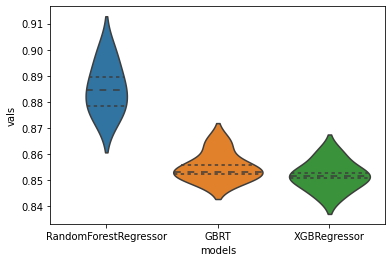

In [ ]:
fig, ax = plt.subplots()
sns.violinplot(x="models", y="vals", data=cv_results, inner="quartile", alpha=0.5, ax=ax)

In [ ]:
arr

[['RandomForestRegressor()',
  array([0.88445805, 0.8895105 , 0.87451363, 0.87846797, 0.89892825])],
 ['GradientBoostingRegressor()',
  array([0.85047443, 0.85568418, 0.8532259 , 0.85240043, 0.86411933])],
 ['XGBRegressor()',
  array([0.84477986, 0.85260318, 0.85061779, 0.85165285, 0.85973467])]]

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

from sklearn.metrics import mean_squared_error

# Randomized Search CV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 50, stop = 200, num = 4)]
#max_features = ['auto', 'sqrt']
max_depth = [int(x) for x in np.linspace(5, 30, num = 2)]
# max_depth.append(None)
min_samples_split = [2, 5]
min_samples_leaf = [ 5, 10]

# bootstrap = [True, False]

# Create the random grid
param_grid = {'n_estimators': n_estimators,
              # 'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf
}

print(param_grid)


# Use the random grid to search for best hyperparameters
# First create the base model to tune

rf = RandomForestRegressor()

{'n_estimators': [50, 100, 150, 200], 'max_depth': [5, 30], 'min_samples_split': [2, 5], 'min_samples_leaf': [5, 10]}


In [ ]:
grid = GridSearchCV(RandomForestRegressor(), param_grid, refit = True, verbose=3,cv =2)
grid.fit(train_x ,y_train)
grid_mean_scores = grid.cv_results_['mean_test_score']
res = pd.DataFrame(grid.cv_results_)[['mean_test_score','params']]

Fitting 2 folds for each of 32 candidates, totalling 64 fits
[CV 1/2] END max_depth=5, min_samples_leaf=5, min_samples_split=2, n_estimators=50;, score=0.775 total time=   0.6s
[CV 2/2] END max_depth=5, min_samples_leaf=5, min_samples_split=2, n_estimators=50;, score=0.781 total time=   0.6s
[CV 1/2] END max_depth=5, min_samples_leaf=5, min_samples_split=2, n_estimators=100;, score=0.779 total time=   1.2s
[CV 2/2] END max_depth=5, min_samples_leaf=5, min_samples_split=2, n_estimators=100;, score=0.781 total time=   1.2s
[CV 1/2] END max_depth=5, min_samples_leaf=5, min_samples_split=2, n_estimators=150;, score=0.780 total time=   1.7s
[CV 2/2] END max_depth=5, min_samples_leaf=5, min_samples_split=2, n_estimators=150;, score=0.782 total time=   1.8s
[CV 1/2] END max_depth=5, min_samples_leaf=5, min_samples_split=2, n_estimators=200;, score=0.781 total time=   2.4s
[CV 2/2] END max_depth=5, min_samples_leaf=5, min_samples_split=2, n_estimators=200;, score=0.787 total time=   2.3s
[CV 1

In [ ]:
print('grid.best_score_' , grid.best_score_)
print('grid.best_params_' , grid.best_params_)
print('grid.best_estimator_ ',grid.best_estimator_)

grid.best_score_ 0.8482747465431638
grid.best_params_ {'max_depth': 30, 'min_samples_leaf': 5, 'min_samples_split': 5, 'n_estimators': 200}
grid.best_estimator_  RandomForestRegressor(max_depth=30, min_samples_leaf=5, min_samples_split=5,
                      n_estimators=200)


In [ ]:
rf1 = RandomForestRegressor(n_estimators = 100,max_depth=40, max_features= 'auto').fit(train_x,y_train)

In [ ]:
pred = rf1.predict(test_x)

In [ ]:
print_evaluate(pred , y_test)

MAE: 165660.60138995646
MSE: 61283110749.951385
RMSE: 247554.25819393893
R2 Square 0.8137940399460692
__________________________________


In [ ]:
rf1.feature_importances_[0:10]

array([8.02734214e-03, 1.38050848e-02, 2.33069428e-01, 7.26807343e-02,
       2.15790900e-02, 9.18132108e-02, 3.23163297e-01, 1.76190063e-01,
       4.69214990e-05, 8.35324128e-05])

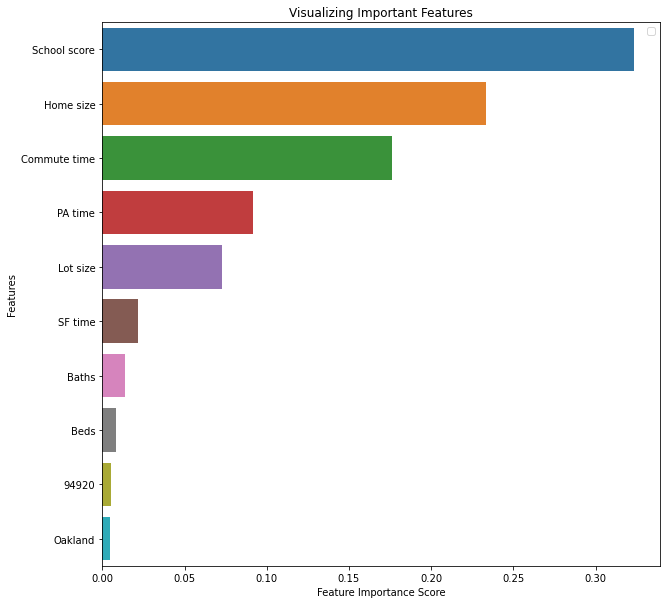

In [ ]:
feature_imp1 = pd.Series(rf1.feature_importances_,index=test_x.columns).sort_values(ascending=False)
feature_imp1 = feature_imp1[0:10]
plt.figure(figsize=(10,10))

# Creating a bar plot
sns.barplot(x=feature_imp1, y=feature_imp1.index)

# Add labels to your graph
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')
plt.title("Visualizing Important Features")
plt.legend()
plt.show()

In [ ]:
from xgboost import XGBClassifier
from sklearn.model_selection import StratifiedKFold
from datetime import datetime
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV

In [ ]:
params = {
        'min_child_weight': [1, 5, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 1.0],
        'max_depth': [3, 4, 5],
        'n_estimators' : [10,20,50,60,90,100,200]
        }

xgb = xgboost.XGBRegressor(learning_rate=0.02,
                    silent=True, nthread=1)

In [ ]:
folds = 3
param_comb = 5

skf = StratifiedKFold(n_splits=folds, shuffle = True, random_state = 1001)

random_search = RandomizedSearchCV(xgb, param_distributions=params, n_iter=param_comb, n_jobs=4, cv=skf.split(train_x,y_train), verbose=3, random_state=1001 )

# Here we go
random_search.fit(train_x,y_train)


Fitting 3 folds for each of 5 candidates, totalling 15 fits


RandomizedSearchCV(cv=<generator object _BaseKFold.split at 0x7f3923351eb0>,
                   estimator=XGBRegressor(learning_rate=0.02, nthread=1,
                                          silent=True),
                   n_iter=5, n_jobs=4,
                   param_distributions={'colsample_bytree': [0.6, 0.8, 1.0],
                                        'gamma': [0.5, 1, 1.5, 2, 5],
                                        'max_depth': [3, 4, 5],
                                        'min_child_weight': [1, 5, 10],
                                        'n_estimators': [10, 20, 50, 60, 90,
                                                         100, 200],
                                        'subsample': [0.6, 0.8, 1.0]},
                   random_state=1001, verbose=3)

In [ ]:
print(random_search.best_estimator_)

XGBRegressor(colsample_bytree=0.8, gamma=1, learning_rate=0.02, max_depth=4,
             nthread=1, silent=True, subsample=0.8)


In [ ]:
tree = xgboost.XGBRegressor().fit(train_x,y_train)

[16:30:09] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [ ]:
pred = tree.predict(test_x)

print_evaluate(pred , y_test)

MAE: 195286.67832436587
MSE: 72103314799.2564
RMSE: 268520.60404977563
R2 Square 0.7705866207928438
__________________________________


In [ ]:
tree.feature_importances_[0:10]

array([0.00204995, 0.0063302 , 0.07178274, 0.02650893, 0.01975165,
       0.09122982, 0.30646545, 0.12346016, 0.        , 0.        ],
      dtype=float32)

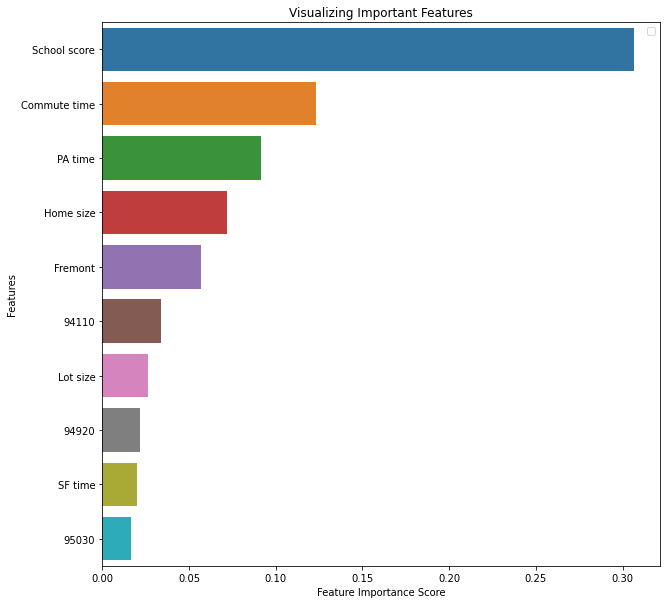

In [ ]:
feature_imp1 = pd.Series(tree.feature_importances_,index=test_x.columns).sort_values(ascending=False)
feature_imp1 = feature_imp1[0:10]
plt.figure(figsize=(10,10))

# Creating a bar plot
sns.barplot(x=feature_imp1, y=feature_imp1.index)

# Add labels to your graph
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')
plt.title("Visualizing Important Features")
plt.legend()
plt.show()

In [ ]:
d = {'predicted_values': pred, 'true_values': y_test}
res = pd.DataFrame(data=d)

In [ ]:
res.head()

,predicted_values,true_values
2100,8.147651e+05,948500
4741,7.044309e+05,595000
1849,8.582469e+05,625000
3648,6.217061e+05,339000
2317,1.012282e+06,799000


In [ ]:
res.to_csv('result.csv')

In [ ]:
from google.colab import files
files.download("result.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
def findGeocode(city):
    # try and catch is used to overcome the exception thrown by geolocator
    # using geocodertimedout  
    try:
        # Specify the user_agent as your app name and it should not be none
        geolocator = Nominatim(user_agent="CS133")
        return geolocator.geocode(city)
    except GeocoderTimedOut:
        return None    

In [ ]:
loc = findGeocode("San Jose")
ca_lat = loc.latitude
ca_long = loc.longitude
ca_shape = "https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/california-counties.geojson"

In [ ]:
df['City'].unique()

array(['Belmont', 'Brisbane', 'Burlingame', 'Hillsborough', 'Daly City',
       'El Granada', 'Half Moon Bay', 'La Honda', 'Los Altos Hills',
       'Los Altos', 'Menlo Park', 'Atherton', 'Portola Valley',
       'Millbrae', 'Montara', 'Moss Beach', 'Mountain View', 'Pacifica',
       'Pescadero', 'Redwood City', 'Woodside', 'San Bruno', 'San Carlos',
       'South San Francisco', 'Sunnyvale', 'San Francisco', 'Palo Alto',
       'East Palo Alto', 'Stanford', 'San Mateo', 'Foster City',
       'Alameda', 'Discovery Bay', 'Danville', 'Alamo', 'Antioch',
       'Benicia', 'Bethel Island', 'Brentwood', 'Byron', 'Clayton',
       'Concord', 'Pleasant Hill', 'Crockett', 'Diablo', 'El Cerrito',
       'Fremont', 'Hayward', 'Castro Valley', 'Hercules', 'Knightsen',
       'Lafayette', 'Livermore', 'Pacheco', 'Martinez', 'Moraga',
       'Newark', 'Oakley', 'Orinda', 'Pinole', 'Pittsburg', 'Bay Point',
       'Pleasanton', 'Dublin', 'Rodeo', 'San Leandro', 'San Lorenzo',
       'San Ramon', 'S

##**Question**: Which homes were undervalued according to our model? Which were overvalued? Are there any homes that are outliers in price according to other attributes, and why did the model under/overpredict the value of these homes?

In [ ]:
result_df = pd.read_csv('result.csv')
result_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1301 entries, 0 to 1300
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Unnamed: 0        1301 non-null   int64  
 1   predicted_values  1301 non-null   float64
 2   true_values       1301 non-null   int64  
dtypes: float64(1), int64(2)
memory usage: 30.6 KB


In [ ]:
result_df.rename( columns={'Unnamed: 0':'Index'}, inplace=True )

In [ ]:
result_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1301 entries, 0 to 1300
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Index             1301 non-null   int64  
 1   predicted_values  1301 non-null   float64
 2   true_values       1301 non-null   int64  
dtypes: float64(1), int64(2)
memory usage: 30.6 KB


In [ ]:
result_df.predicted_values.mean()

1220822.999144431

In [ ]:
result_df.true_values.mean()

1174366.6210607225

## From these we can tell that on average, our model overpredicted the values of homes for the test values, but we don't really get an impression if this is a result of outliers or a trend. A scatter plot here shows the distribution of True values, and on hover the predicted values as well.

In [ ]:
import plotly.express as px
configure_plotly_browser_state()
fig = px.scatter(result_df, x="Index", y="true_values", hover_data=['predicted_values', 'true_values'])
fig.show()

## While this is nice to see how the test value differed per point, it still doesn't help understand the distribution of values on the true vs predicted values, a line plot might help better portray the distribution.

In [ ]:
import plotly.graph_objects as go
configure_plotly_browser_state()
fig = go.Figure()
fig.add_trace(go.Scatter(x=result_df.index, y=result_df.predicted_values, mode='lines', name='predicted'))
fig.add_trace(go.Scatter(x=result_df.index, y=result_df.true_values, mode='lines', name='true'))

## This helps a bit, but is still very unclear on who exactly has larger values, a boxplot is the most natural choice for modeling distribution of a single variable in the end.

In [ ]:
fig = go.Figure()
configure_plotly_browser_state()
fig.add_trace(go.Box(y=result_df.predicted_values, name="Predicted Values"))
fig.add_trace(go.Box(y=result_df.true_values, name="True Values"))
fig.show()

## Answer: As we can see now the, median and average values are higher, but the predicted values range is tighter than the true values were, as it didn't find the outlier price values on either end of the distribution.